In [1]:
import pandas as pd
import numpy as np
import plotly.express as px

In [2]:
census_data = pd.read_csv('adult.data')
census_data.head()

,age,workclass,fnlwgt,education,education_num,marital-status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,income
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K


In [3]:
census_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32561 entries, 0 to 32560
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             32561 non-null  int64 
 1   workclass       32561 non-null  object
 2   fnlwgt          32561 non-null  int64 
 3   education       32561 non-null  object
 4   education_num   32561 non-null  int64 
 5   marital-status  32561 non-null  object
 6   occupation      32561 non-null  object
 7   relationship    32561 non-null  object
 8   race            32561 non-null  object
 9   sex             32561 non-null  object
 10  capital_gain    32561 non-null  int64 
 11  capital_loss    32561 non-null  int64 
 12  hours_per_week  32561 non-null  int64 
 13  native_country  32561 non-null  object
 14  income          32561 non-null  object
dtypes: int64(6), object(9)
memory usage: 3.7+ MB


In [4]:
data_description = census_data.describe()

In [5]:
categorical_features = list(set(census_data.columns).difference(census_data.describe().columns))
categorical_features

['race',
 'education',
 'occupation',
 'relationship',
 'native_country',
 'income',
 'workclass',
 'sex',
 'marital-status']

In [6]:
numerical_features = ['age', 'fnlwgt', 'education_num', 'capital_gain', 'capital_loss', 'hours_per_week']

In [7]:
data_description.loc[['mean', '50%']]

,age,fnlwgt,education_num,capital_gain,capital_loss,hours_per_week
mean,38.581647,189778.366512,10.080679,1077.648844,87.30383,40.437456
50%,37.000000,178356.000000,10.000000,0.000000,0.00000,40.000000


In [8]:
numerical_data = census_data[numerical_features].copy()
categorical_data = census_data[categorical_features].copy()

In [9]:
px.histogram(numerical_data, x='capital_gain')

In [10]:
px.histogram(numerical_data, x='capital_loss')

In [11]:
numerical_data.describe()

,age,fnlwgt,education_num,capital_gain,capital_loss,hours_per_week
count,32561.000000,3.256100e+04,32561.000000,32561.000000,32561.000000,32561.000000
mean,38.581647,1.897784e+05,10.080679,1077.648844,87.303830,40.437456
std,13.640433,1.055500e+05,2.572720,7385.292085,402.960219,12.347429
min,17.000000,1.228500e+04,1.000000,0.000000,0.000000,1.000000
25%,28.000000,1.178270e+05,9.000000,0.000000,0.000000,40.000000
50%,37.000000,1.783560e+05,10.000000,0.000000,0.000000,40.000000
75%,48.000000,2.370510e+05,12.000000,0.000000,0.000000,45.000000
max,90.000000,1.484705e+06,16.000000,99999.000000,4356.000000,99.000000


In [12]:
categorical_data.describe()

,race,education,occupation,relationship,native_country,income,workclass,sex,marital-status
count,32561,32561,32561,32561,32561,32561,32561,32561,32561
unique,5,16,15,6,42,2,9,2,7
top,White,HS-grad,Prof-specialty,Husband,United-States,<=50K,Private,Male,Married-civ-spouse
freq,27816,10501,4140,13193,29170,24720,22696,21790,14976


In [13]:
numerical_correlations = numerical_data.corr()

fig = px.imshow(numerical_correlations, text_auto=True)
fig.show()

In [14]:
px.scatter_matrix(numerical_data, height=1000)

In [15]:
px.histogram(census_data, x='age', color='income', barmode='overlay')

In [16]:
px.histogram(census_data, x='hours_per_week', color='income', barmode='overlay')

In [17]:
px.histogram(census_data, x='fnlwgt', color='income', barmode='overlay')

In [18]:
px.histogram(census_data, x='education_num', color='income', barmode='overlay')

In [19]:
px.histogram(census_data, x='capital_gain', color='income', barmode='overlay')

In [20]:
px.histogram(census_data, x='capital_loss', color='income', barmode='overlay')

In [21]:
important_numerical_features = ['age', 'education_num', 'capital_gain']

In [22]:
categorical_features

['race',
 'education',
 'occupation',
 'relationship',
 'native_country',
 'income',
 'workclass',
 'sex',
 'marital-status']

In [23]:
px.violin(census_data, x='sex', y='age', color='income')

In [24]:
px.histogram(census_data, x='sex', color='income', barmode='group')

In [25]:
px.violin(census_data, x='sex', y='education_num', color='income')

In [26]:
px.violin(census_data, x='sex', y='capital_gain', color='income')

In [27]:
px.histogram(census_data, x='relationship', color='income', barmode='group')

In [28]:
px.histogram(census_data, x='workclass', color='income', barmode='group')

In [29]:
px.histogram(census_data, x='race', color='income', barmode='group')

In [30]:
px.histogram(census_data, x='education', color='income', barmode='group')

In [31]:
px.histogram(census_data, x='occupation', color='income', barmode='group')

In [32]:
px.histogram(census_data, x='marital-status', color='income', barmode='group')

In [33]:
px.histogram(census_data, x='native_country', color='income', barmode='group')

In [34]:
important_categorical_features = ['marital-status', 'occupation', 'education', 'relationship']

In [35]:

for numerical_feature in important_numerical_features:

    for categorical_feature in important_categorical_features:

        fig = px.violin(census_data, x=categorical_feature, y=numerical_feature, color='income')
        fig.show()



In [36]:
categorical_data.describe()

,race,education,occupation,relationship,native_country,income,workclass,sex,marital-status
count,32561,32561,32561,32561,32561,32561,32561,32561,32561
unique,5,16,15,6,42,2,9,2,7
top,White,HS-grad,Prof-specialty,Husband,United-States,<=50K,Private,Male,Married-civ-spouse
freq,27816,10501,4140,13193,29170,24720,22696,21790,14976


In [37]:
(categorical_data.query('occupation == "?"').shape[0] / categorical_data.shape[0]) * 100

5.660145572924664

In [38]:
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder

label_encoder = LabelEncoder()

In [39]:
income_data = census_data['income'].copy()
encoded_income_data = label_encoder.fit_transform(income_data)
encoded_income_data

array([0, 0, 0, ..., 0, 0, 1])

In [40]:
import copy

categorical_features_dummy = copy.deepcopy(categorical_features)
categorical_features_dummy.remove('income')

In [41]:
categorical_data = categorical_data.query('occupation != "?"')
categorical_data = categorical_data.query('native_country != "?"')
categorical_data = categorical_data.query('workclass != "?"')
categorical_dummy = pd.get_dummies(categorical_data[categorical_features_dummy])
categorical_dummy

,race_Amer-Indian-Eskimo,race_Asian-Pac-Islander,race_Black,race_Other,race_White,education_10th,education_11th,education_12th,education_1st-4th,education_5th-6th,...,workclass_Without-pay,sex_Female,sex_Male,marital-status_Divorced,marital-status_Married-AF-spouse,marital-status_Married-civ-spouse,marital-status_Married-spouse-absent,marital-status_Never-married,marital-status_Separated,marital-status_Widowed
0,0,0,0,0,1,0,0,0,0,0,...,0,0,1,0,0,0,0,1,0,0
1,0,0,0,0,1,0,0,0,0,0,...,0,0,1,0,0,1,0,0,0,0
2,0,0,0,0,1,0,0,0,0,0,...,0,0,1,1,0,0,0,0,0,0
3,0,0,1,0,0,0,1,0,0,0,...,0,0,1,0,0,1,0,0,0,0
4,0,0,1,0,0,0,0,0,0,0,...,0,1,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,0,0,0,0,1,0,0,0,0,0,...,0,1,0,0,0,1,0,0,0,0
32557,0,0,0,0,1,0,0,0,0,0,...,0,0,1,0,0,1,0,0,0,0
32558,0,0,0,0,1,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1
32559,0,0,0,0,1,0,0,0,0,0,...,0,0,1,0,0,0,0,1,0,0


In [42]:
encoded_income_df = pd.DataFrame(encoded_income_data, columns=['income'])
encoded_income_df

,income
0,0
1,0
2,0
3,0
4,0
...,...
32556,0
32557,1
32558,0
32559,0


In [43]:
numerical_data.reset_index(drop=True, inplace=True)
categorical_dummy.reset_index(drop=True, inplace=True)
encoded_income_df.reset_index(drop=True, inplace=True)

In [44]:
transformed_data = pd.concat([categorical_dummy, numerical_data, encoded_income_df], axis=1, join='inner')
transformed_data.head()

,race_Amer-Indian-Eskimo,race_Asian-Pac-Islander,race_Black,race_Other,race_White,education_10th,education_11th,education_12th,education_1st-4th,education_5th-6th,...,marital-status_Never-married,marital-status_Separated,marital-status_Widowed,age,fnlwgt,education_num,capital_gain,capital_loss,hours_per_week,income
0,0,0,0,0,1,0,0,0,0,0,...,1,0,0,39,77516,13,2174,0,40,0
1,0,0,0,0,1,0,0,0,0,0,...,0,0,0,50,83311,13,0,0,13,0
2,0,0,0,0,1,0,0,0,0,0,...,0,0,0,38,215646,9,0,0,40,0
3,0,0,1,0,0,0,1,0,0,0,...,0,0,0,53,234721,7,0,0,40,0
4,0,0,1,0,0,0,0,0,0,0,...,0,0,0,28,338409,13,0,0,40,0


In [45]:
pd.set_option('display.max_columns', None)

In [46]:
transformed_data

,race_Amer-Indian-Eskimo,race_Asian-Pac-Islander,race_Black,race_Other,race_White,education_10th,education_11th,education_12th,education_1st-4th,education_5th-6th,education_7th-8th,education_9th,education_Assoc-acdm,education_Assoc-voc,education_Bachelors,education_Doctorate,education_HS-grad,education_Masters,education_Preschool,education_Prof-school,education_Some-college,occupation_Adm-clerical,occupation_Armed-Forces,occupation_Craft-repair,occupation_Exec-managerial,occupation_Farming-fishing,occupation_Handlers-cleaners,occupation_Machine-op-inspct,occupation_Other-service,occupation_Priv-house-serv,occupation_Prof-specialty,occupation_Protective-serv,occupation_Sales,occupation_Tech-support,occupation_Transport-moving,relationship_Husband,relationship_Not-in-family,relationship_Other-relative,relationship_Own-child,relationship_Unmarried,relationship_Wife,native_country_Cambodia,native_country_Canada,native_country_China,native_country_Columbia,native_country_Cuba,native_country_Dominican-Republic,native_country_Ecuador,native_country_El-Salvador,native_country_England,native_country_France,native_country_Germany,native_country_Greece,native_country_Guatemala,native_country_Haiti,native_country_Holand-Netherlands,native_country_Honduras,native_country_Hong,native_country_Hungary,native_country_India,native_country_Iran,native_country_Ireland,native_country_Italy,native_country_Jamaica,native_country_Japan,native_country_Laos,native_country_Mexico,native_country_Nicaragua,native_country_Outlying-US(Guam-USVI-etc),native_country_Peru,native_country_Philippines,native_country_Poland,native_country_Portugal,native_country_Puerto-Rico,native_country_Scotland,native_country_South,native_country_Taiwan,native_country_Thailand,native_country_Trinadad&Tobago,native_country_United-States,native_country_Vietnam,native_country_Yugoslavia,workclass_Federal-gov,workclass_Local-gov,workclass_Private,workclass_Self-emp-inc,workclass_Self-emp-not-inc,workclass_State-gov,workclass_Without-pay,sex_Female,sex_Male,marital-status_Divorced,marital-status_Married-AF-spouse,marital-status_Married-civ-spouse,marital-status_Married-spouse-absent,marital-status_Never-married,marital-status_Separated,marital-status_Widowed,age,fnlwgt,education_num,capital_gain,capital_loss,hours_per_week,income
0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,39,77516,13,2174,0,40,0
1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,0,50,83311,13,0,0,13,0
2,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,1,0,0,0,0,0,0,38,215646,9,0,0,40,0
3,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,53,234721,7,0,0,40,0
4,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,28,338409,13,0,0,40,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30157,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

### Train Test Splitting

In [47]:
X = transformed_data.drop(['income'], axis=1)
Y = transformed_data["income"]

In [48]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

### SVM

In [108]:
from sklearn.svm import SVC
model = SVC()
model.fit(X_train, y_train)
print(model.score(X_train, y_train))


0.7955986572174562


In [109]:

predictions = model.predict(X_test)
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, predictions)
print('Confusion matrix\n\n', cm)
print('\nTrue Positives(TP) = ', cm[0,0])
print('\nTrue Negatives(TN) = ', cm[1,1])
print('\nFalse Positives(FP) = ', cm[0,1])
print('\nFalse Negatives(FN) = ', cm[1,0])

from sklearn.metrics import classification_report
print(classification_report(y_test,predictions))

Confusion matrix

 [[4591    3]
 [1226  213]]

True Positives(TP) =  4591

True Negatives(TN) =  213

False Positives(FP) =  3

False Negatives(FN) =  1226
              precision    recall  f1-score   support

           0       0.79      1.00      0.88      4594
           1       0.99      0.15      0.26      1439

    accuracy                           0.80      6033
   macro avg       0.89      0.57      0.57      6033
weighted avg       0.84      0.80      0.73      6033



In [102]:
transformed_data.columns

Index(['race_Amer-Indian-Eskimo', 'race_Asian-Pac-Islander', 'race_Black',
       'race_Other', 'race_White', 'education_10th', 'education_11th',
       'education_12th', 'education_1st-4th', 'education_5th-6th',
       ...
       'marital-status_Never-married', 'marital-status_Separated',
       'marital-status_Widowed', 'age', 'fnlwgt', 'education_num',
       'capital_gain', 'capital_loss', 'hours_per_week', 'income'],
      dtype='object', length=105)

capital_gain	education_num	age	hours_per_week	capital_loss

In [113]:
fig = px.scatter_3d(transformed_data, x='capital_gain', y='age', z='hours_per_week',
              color='income', height=1000)
fig.show()

In [112]:
fig = px.scatter_3d(transformed_data, x='education_num', y='age', z='hours_per_week',
              color='income', height=1000)
fig.show()

### Naive Bayes

In [54]:
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score

gnb = GaussianNB()
gnb.fit(X_train, y_train)

y_pred_GNB = gnb.predict(X_test)
print('Model accuracy score: {0:0.4f}'.format(accuracy_score(y_test, y_pred_GNB)))

Model accuracy score: 0.7998


In [107]:
cm = confusion_matrix(y_test, y_pred_GNB)
print('Confusion matrix\n\n', cm)
print('\nTrue Positives(TP) = ', cm[0,0])
print('\nTrue Negatives(TN) = ', cm[1,1])
print('\nFalse Positives(FP) = ', cm[0,1])
print('\nFalse Negatives(FN) = ', cm[1,0])

from sklearn.metrics import classification_report
print(classification_report(y_test,y_pred_GNB))

Confusion matrix

 [[4377  217]
 [ 991  448]]

True Positives(TP) =  4377

True Negatives(TN) =  448

False Positives(FP) =  217

False Negatives(FN) =  991
              precision    recall  f1-score   support

           0       0.82      0.95      0.88      4594
           1       0.67      0.31      0.43      1439

    accuracy                           0.80      6033
   macro avg       0.74      0.63      0.65      6033
weighted avg       0.78      0.80      0.77      6033



### Random Forest

In [83]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(criterion='gini', max_depth=4, n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

RandomForestClassifier(max_depth=4, random_state=42)

In [84]:
sorted_idx = (-rf.feature_importances_).argsort()

feature_importance = pd.DataFrame([X_train.columns[sorted_idx], rf.feature_importances_[sorted_idx]])
feature_importance

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103
0,capital_gain,education_num,age,hours_per_week,capital_loss,fnlwgt,native_country_Columbia,relationship_Unmarried,occupation_Machine-op-inspct,native_country_Greece,native_country_Taiwan,marital-status_Married-civ-spouse,occupation_Transport-moving,native_country_Trinadad&Tobago,education_10th,education_11th,relationship_Other-relative,occupation_Craft-repair,education_7th-8th,relationship_Own-child,occupation_Tech-support,education_Bachelors,relationship_Husband,native_country_United-States,race_Amer-Indian-Eskimo,marital-status_Divorced,occupation_Adm-clerical,occupation_Prof-specialty,workclass_Private,education_5th-6th,race_Other,native_country_Cuba,native_country_Iran,native_country_Canada,native_country_Mexico,native_country_El-Salvador,education_HS-grad,sex_Female,native_country_Poland,marital-status_Never-married,native_country_Dominican-Republic,education_Assoc-acdm,occupation_Farming-fishing,native_country_Jamaica,native_country_Puerto-Rico,native_country_Guatemala,relationship_Not-in-family,marital-status_Married-spouse-absent,native_country_Hong,sex_Male,occupation_Armed-Forces,education_Some-college,occupation_Sales,native_country_Germany,native_country_Outlying-US(Guam-USVI-etc),occupation_Protective-serv,native_country_Thailand,workclass_Self-emp-not-inc,occupation_Handlers-cleaners,education_Prof-school,education_Masters,native_country_Philippines,native_country_Yugoslavia,education_12th,marital-status_Widowed,education_9th,native_country_Nicaragua,marital-status_Separated,relationship_Wife,race_White,workclass_Federal-gov,workclass_Local-gov,education_Assoc-voc,occupation_Other-service,occupation_Exec-managerial,native_country_Ireland,native_country_Vietnam,race_Asian-Pac-Islander,race_Black,education_Preschool,native_country_South,native_country_Japan,education_Doctorate,native_country_France,native_country_Peru,workclass_Self-emp-inc,native_country_Cambodia,workclass_State-gov,native_country_Italy,native_country_China,occupation_Priv-house-serv,native_country_Scotland,native_country_Ecuador,education_1st-4th,native_country_England,workclass_Without-pay,native_country_India,native_country_Portugal,native_country_Hungary,native_country_Honduras,native_country_Haiti,native_country_Holand-Netherlands,native_country_Laos,marital-status_Married-AF-spouse
1,0.242484,0.218896,0.194204,0.172141,0.09503,0.018986,0.003295,0.002976,0.00279,0.002274,0.002055,0.001936,0.001725,0.001645,0.001578,0.001555,0.001472,0.001453,0.001379,0.001316,0.001209,0.001209,0.001204,0.001179,0.001162,0.001094,0.001024,0.00102,0.001004,0.001003,0.000983,0.000972,0.00092,0.000819,0.000792,0.000779,0.000684,0.000669,0.000657,0.000603,0.000593,0.000572,0.000572,0.000501,0.00045,0.000442,0.000428,0.000419,0.000417,0.000412,0.000407,0.000403,0.000341,0.000333,0.000284,0.000277,0.000273,0.000267,0.000262,0.000257,0.000252,0.000251,0.000239,0.000228,0.000217,0.000177,0.000173,0.000173,0.000166,0.000165,0.00015,0.000143,0.000135,0.00013,0.000122,0.000098,0.00009,0.00009,0.000084,0.000083,0.000075,0.000075,0.000069,0.000065,0.000058,0.000049,0.000045,0.000043,0.000041,0.000031,0.000027,0.000025,0.000024,0.000023,0.000022,0.000021,0.00002,0.000018,0.000009,0.000006,0.000006,0.0,0.0,0.0


Text(0.5, 1.0, 'Random Forest Feature Importance')

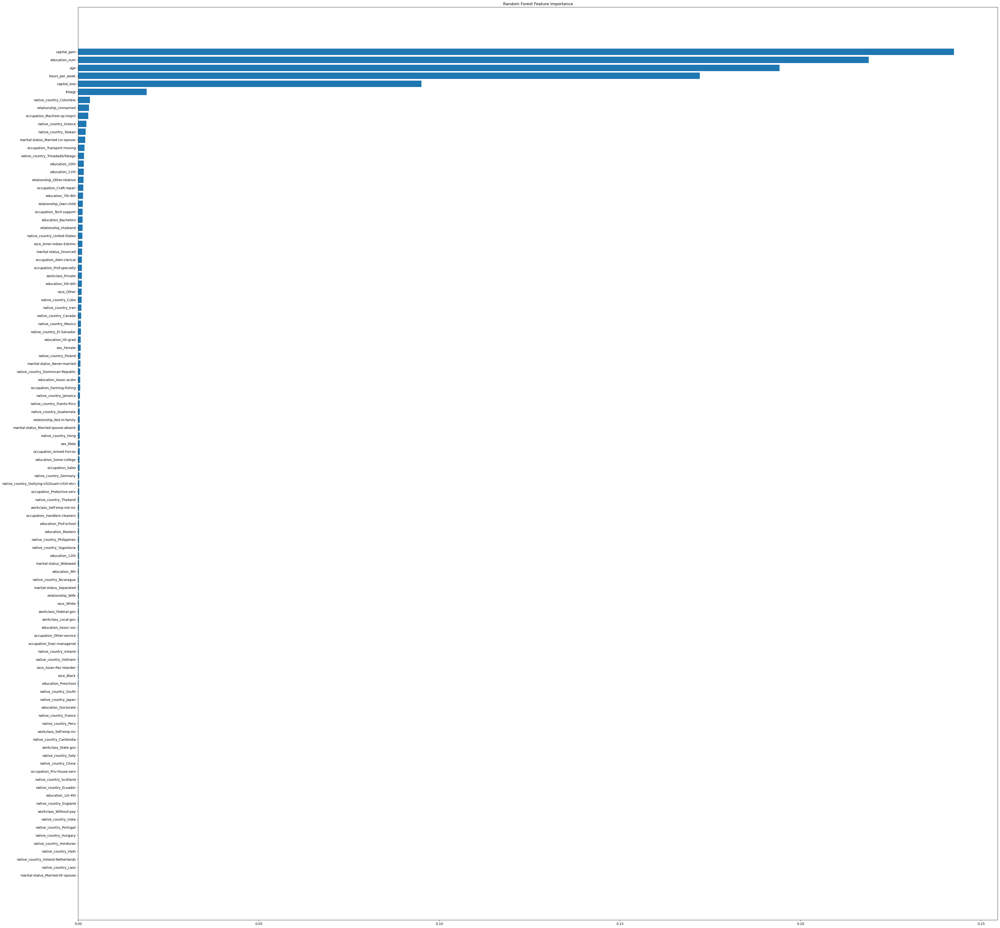

In [85]:
import matplotlib.pyplot as plt
plt.figure(figsize = (50,50))

sorted_idx = rf.feature_importances_.argsort()

plt.barh(X_train.columns[sorted_idx], rf.feature_importances_[sorted_idx])
plt.title('Random Forest Feature Importance')

In [86]:
from sklearn.metrics import accuracy_score

rfc_pred = rf.predict(X_test)
print('Model accuracy score: {0:0.4f}'.format(accuracy_score(y_test, rfc_pred)))

Model accuracy score: 0.7848


In [87]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

y_pred = rf.predict(X_test)
print(classification_report(y_test, y_pred))
print(confusion_matrix(y_test, y_pred)) 

              precision    recall  f1-score   support

           0       0.78      1.00      0.88      4594
           1       1.00      0.10      0.18      1439

    accuracy                           0.78      6033
   macro avg       0.89      0.55      0.53      6033
weighted avg       0.83      0.78      0.71      6033

[[4594    0]
 [1298  141]]
